In [1]:
import yfinance as yf
import numpy as np
import pandas as pd

# Define the ticker symbol
ticker = "TSLA"

In [2]:
data = yf.download(ticker)

[*********************100%***********************]  1 of 1 completed


In [3]:
data.head()

Price,Close,High,Low,Open,Volume
Ticker,TSLA,TSLA,TSLA,TSLA,TSLA
Date,,,,,
2010-06-29,1.592667,1.666667,1.169333,1.266667,281494500
2010-06-30,1.588667,2.028000,1.553333,1.719333,257806500
2010-07-01,1.464000,1.728000,1.351333,1.666667,123282000
2010-07-02,1.280000,1.540000,1.247333,1.533333,77097000
2010-07-06,1.074000,1.333333,1.055333,1.333333,103003500


In [253]:
data.to_csv('data.csv', index=False)

In [4]:
data = data.dropna()

In [41]:
from sklearn.preprocessing import MinMaxScaler

# Normalize the data
scaler = MinMaxScaler()
data_normalized = scaler.fit_transform(data)

In [6]:
data = pd.DataFrame(data_normalized, columns=data.columns)
train_size = int(len(data) * 0.75)
train_data = data[:train_size]
test_data = data[train_size:]

In [7]:
test_data.head()

Price,Close,High,Low,Open,Volume
Ticker,TSLA,TSLA,TSLA,TSLA,TSLA
2744,0.419989,0.417942,0.416677,0.406026,0.111692
2745,0.418770,0.417607,0.432785,0.424074,0.090146
2746,0.428823,0.425936,0.437013,0.424250,0.092228
2747,0.436982,0.429328,0.447754,0.433151,0.084768
2748,0.433063,0.432378,0.452259,0.438950,0.072819


In [25]:
from stable_baselines3 import PPO

import gym

# Define the trading environment
class TradingEnvironment(gym.Env):
    def __init__(self, data):
        self.data = data
        self.action_space = gym.spaces.Discrete(3)  # Buy, Sell, Hold
        self.observation_space = gym.spaces.Box(low=0, high=1, shape=(len(data.columns),))

    def reset(self):
        self.current_step = 0
        self.account_balance =500 # Initial account balance
        self.shares_held = 0
        self.net_worth = self.account_balance
        self.max_net_worth = self.account_balance

        return self._next_observation()

    def _next_observation(self):
        return self.data.iloc[self.current_step].values

    def step(self, action):
        self._take_action(action)
        self.current_step += 1

        # Ensure we don't exceed the data length
        if self.current_step >= len(self.data):
            done = True
            self.current_step = 0  # Restart the episode
        else:
            done = False

        return self._next_observation(), self._get_reward(), done, {}

    def _take_action(self, action):
        current_price = self.data.iloc[self.current_step].values[0]

        if action == 0:  # Buy
            # Ensure you only buy if you have enough balance

            if self.account_balance > current_price:
                self.shares_held += self.account_balance / current_price
                self.account_balance = 0  # Spend all the balance
        elif action == 1:  # Sell
            if self.shares_held > 0:
                self.account_balance += self.shares_held * current_price
                self.shares_held = 0  # Sell all shares

        # Calculate the net worth after the action

        self.net_worth = self.account_balance + self.shares_held * current_price


        if self.net_worth > self.max_net_worth:
            self.max_net_worth = self.net_worth

    def _get_reward(self):

        return self.net_worth - (self.account_balance + self.shares_held * self.data.iloc[self.current_step].values[0])
# Create the trading environment
env = TradingEnvironment(train_data)

In [9]:
from stable_baselines3 import DDPG, A2C, DQN

model = DQN("MlpPolicy", env, device="cuda",verbose=0)


model.learn(total_timesteps=1000000,log_interval=4)


J:\Projects\DLproject\ModelTesting\DeepReinforcmentLearning\.venv\Lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


buying 0.001118058799874204
buying 0.0008576884648893463
buying 0.0
buying 0.00023113085364794873
buying 0.00017404513641278803
buying 0.000325809798503661
buying 0.0006738983285275802
buying 0.0008507274661010301
buying 0.0007170617992144435
buying 0.000661367086672953
buying 0.0008562954684223543
buying 0.000527701419786366
buying 0.00029239356851076337
buying 0.00041631398647670693
buying 0.0007323770422297329
buying 0.000659974090205961
buying 0.0007100985596811401
buying 0.0006850363249435503
buying 0.0007323770422297329
buying 0.0006919995644768537
buying 0.0005235244221587121
buying 0.0005987113753431459
buying 0.0007407310374850412
buying 0.0006182036159860897
buying 0.0006168126112924195
buying 0.0006752913249945722
buying 0.0007240227980027597
buying 0.0008409802254070648
buying 0.0019548600358802928
buying 0.0019061283139004404
buying 0.001961823026441931
buying 0.0021149809339714607


C:\Users\PKM\AppData\Local\Temp\ipykernel_10796\845040681.py:44: RuntimeWarning: divide by zero encountered in scalar divide
  self.shares_held += self.account_balance / current_price
C:\Users\PKM\AppData\Local\Temp\ipykernel_10796\845040681.py:53: RuntimeWarning: invalid value encountered in scalar multiply
  self.net_worth = self.account_balance + self.shares_held * current_price
C:\Users\PKM\AppData\Local\Temp\ipykernel_10796\845040681.py:61: RuntimeWarning: invalid value encountered in scalar subtract
  return self.net_worth - (self.account_balance + self.shares_held * self.data.iloc[self.current_step].values[0])


buying 0.0025800266424280205
buying 0.002719260560607596
buying 0.0023043413133995386
buying 0.002184597893061249
buying 0.002020301989115749
buying 0.002307125314560201
buying 0.002262570839179667
buying 0.0021887746417172385
buying 0.002053718468080312
buying 0.001772462647013853
buying 0.0022138371254264927
buying 0.0016610754626758591
buying 0.0015065245586793367
buying 0.001513485557467653
buying 0.0017320851692609746
buying 0.0009495836575560621
buying 0.0012099537435692545
buying 0.0012364072319721794
buying 0.0012461542236944794
buying 0.001269823461965077
buying 0.0011291967962901743
buying 0.0009370524157014345
buying 0.001087426322070303
buying 0.001126412795129512
buying 0.0012740007085643964
buying 0.0012336232308115171
buying 0.0011431210346117934
buying 0.0011514750298671017
buying 0.0010373016036234585
buying 0.0009955311294035873
buying 0.0009969241258705793
buying 0.0011305897927571659
buying 0.0013965281300633479
buying 0.0015928495082797411
buying 0.0013185571757182

In [10]:
def simulate_trading_strategy(model, data):
    env = TradingEnvironment(data)
    obs = env.reset()

    # Initialize a list to store net worth at each time step
    net_worth_history = [env.net_worth]

    for i in range(len(data)):
        action, _ = model.predict(obs)
        obs, _, done, _ = env.step(action)

        # Append the current net worth to the history
        net_worth_history.append(env.net_worth)

        if done:
            print("Simulation terminated early.")
            break

    return net_worth_history


In [11]:
net_worth = simulate_trading_strategy(model, test_data)
from stable_baselines3 import PPO
from stable_baselines3.common.envs import DummyVecEnv


buying 0.41998859762555213
buying 0.41877030158839584
buying 0.42882305242511154
buying 0.43698224826599286
buying 0.43306275705225844
buying 0.43214380064410135
buying 0.419069641217395
buying 0.3965971161282377
buying 0.4148438630693147
buying 0.4190766203911149
buying 0.4180045045815982
buying 0.4146559034044752
buying 0.4225505280114642
buying 0.4223903894363848
buying 0.4278205690109279
buying 0.41505967569228736
buying 0.4188956080316221
buying 0.4270617511778502
buying 0.4317330810509425
buying 0.4300065481987879
buying 0.4320115468955283
buying 0.4548878761408709
buying 0.4710739503373142
buying 0.4655393381039581
buying 0.4772698950502818
buying 0.47172833551157894
buying 0.47099039146291455
buying 0.46975118977297176
buying 0.4704334597737429
buying 0.4569833491489845
buying 0.4465894473776966
buying 0.4522702398386924
buying 0.4551524155063901
buying 0.4751674428684483
buying 0.4632210732991519
buying 0.4526670648211578
buying 0.4462901077486975
buying 0.44768243697162663
bu

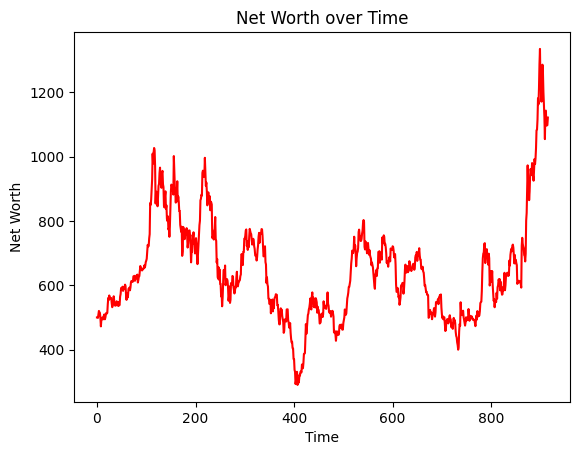

In [12]:
import matplotlib.pyplot as plt


# Plot the net worth over time
plt.plot(net_worth,color='red')
plt.xlabel("Time")
plt.ylabel("Net Worth")
plt.title("Net Worth over Time")
plt.show()

[500, 500.0, 498.5496081988368, 510.51749362900074, 520.23108572056, 515.5648980717839, 514.4708726466265, 498.90597457484256, 472.1522421923351, 493.87514972391665, 498.91428334055587, 497.6379203445389, 493.6513821431988, 503.0499999290412, 502.85935359246827, 509.32402859226966, 494.1320764883488, 498.6987865859819, 508.4206495036852, 513.9819074753326, 511.9264554203058, 514.3134234333373, 541.5478881005644, 560.817547191255, 554.2285442223094, 568.1938721057849, 561.5965983106954, 560.7180696401119, 559.2427894813782, 560.0550377241024, 544.0425665513134, 531.6685380300025, 538.4315698040945, 541.8628244667119, 565.6908848893224, 551.4686302414148, 538.9039933231005, 536.5999232693548, 536.5999232693548, 538.2739997080155, 550.2271123926824, 545.8660455612297, 540.8186418753642, 535.8968035016866, 547.816388676996, 537.068657008749, 538.9101794084295, 564.3314267120322, 572.5763585446088, 591.3849081226177, 591.4434950503977, 592.4311963174923, 595.5366866613728, 582.5372857818312

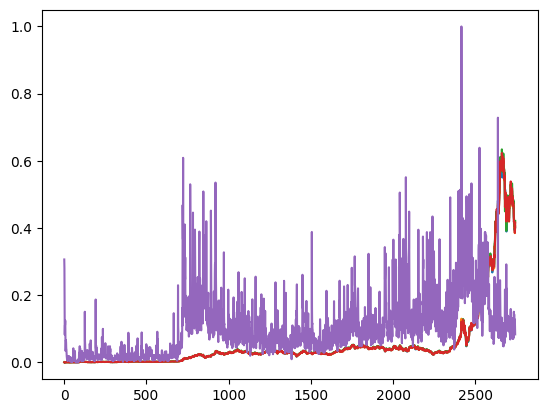

In [13]:
print(net_worth)
plt.plot(train_data)

In [26]:
def evaluate_model(model, env, num_episodes=10):
    total_rewards = []

    for _ in range(num_episodes):
        obs = env.reset()
        done = False
        total_reward = 0

        while not done:
            action, _ = model.predict(obs)
            obs, reward, done, _ = env.step(action)
            total_reward += reward

        total_rewards.append(total_reward)

    avg_total_reward = np.mean(total_rewards)
    print(f"Average total reward over {num_episodes} episodes: {avg_total_reward}")



In [28]:
test_env = TradingEnvironment(test_data)
evaluate_model(model, test_env)


Average total reward over 10 episodes: 24.769025591912396


J:\Projects\DLproject\ModelTesting\DeepReinforcmentLearning\.venv\Lib\site-packages\stable_baselines3\common\vec_env\patch_gym.py:49: UserWarning: You provided an OpenAI Gym environment. We strongly recommend transitioning to Gymnasium environments. Stable-Baselines3 is automatically wrapping your environments in a compatibility layer, which could potentially cause issues.
  warnings.warn(


buying 0.04422033248939741
buying 0.04319685664068315
buying 0.04723323276384997
buying 0.045935842014824285
buying 0.047103498364060886
buying 0.03330772929503262
buying 0.02331775975105954
buying 0.015605365253761633
buying 0.027459863566162535
buying 0.04152896314631399
buying 0.0406894997651924
buying 0.03956055335578479
buying 0.04163029623155462
buying 0.045972681909250884
buying 0.04700034198455297
buying 0.054975711616558426
buying 0.05053213310702667
buying 0.0455962885208899
buying 0.03984998963293579
buying 0.036347207589766256
buying 0.03068767880848186
buying 0.04202115909621637
buying 0.03568135454868673
buying 0.04034211545613561
buying 0.03808408238391517
buying 0.04993867419858619
buying 0.03112195010204602
buying 0.029645525881311474
buying 0.031150865679080098
buying 0.059954964631597524
buying 0.06124319215815158
buying 0.06313923119160927
buying 0.06597227984948936
buying 0.06457736623273039
buying 0.06389440227621926
buying 0.06595774024648601
buying 0.06438844489

In [32]:
model.save("DQN")
model = DQN.load("DQN")


Model's environment: None


In [34]:
test_data.head()

Price,Close,High,Low,Open,Volume
Ticker,TSLA,TSLA,TSLA,TSLA,TSLA
2744,0.419989,0.417942,0.416677,0.406026,0.111692
2745,0.418770,0.417607,0.432785,0.424074,0.090146
2746,0.428823,0.425936,0.437013,0.424250,0.092228
2747,0.436982,0.429328,0.447754,0.433151,0.084768
2748,0.433063,0.432378,0.452259,0.438950,0.072819


In [37]:
import yfinance as yf

# Fetch 1-minute interval data for NVIDIA (NVDA) for the past 7 days
nvda = yf.Ticker("NVDA")
datas = nvda.history(period="5d", interval="1m")  # '7d' is the maximum period for '1m' interval

# Display the data
print(datas)

# Save it to a CSV file if needed
datas.to_csv("nvda_1m_data.csv")


                                 Open        High         Low       Close  \
Datetime                                                                    
2025-01-06 09:30:00-05:00  148.560104  148.600006  148.560104  148.560104   
2025-01-06 09:31:00-05:00  148.559998  148.789993  148.104996  148.474396   
2025-01-06 09:32:00-05:00  148.460007  149.289902  148.240005  148.771805   
2025-01-06 09:33:00-05:00  148.779999  149.350006  148.600006  149.289993   
2025-01-06 09:34:00-05:00  149.315002  149.399994  148.820007  149.020004   
...                               ...         ...         ...         ...   
2025-01-13 15:55:00-05:00  133.190002  133.350006  133.100006  133.330002   
2025-01-13 15:56:00-05:00  133.330002  133.357605  133.250000  133.345001   
2025-01-13 15:57:00-05:00  133.339996  133.395004  133.289993  133.354706   
2025-01-13 15:58:00-05:00  133.350006  133.449997  133.339996  133.360001   
2025-01-13 15:59:00-05:00  133.365005  133.490005  133.139999  133.240005   

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Datetime,,,,,,,
2025-01-06 09:30:00-05:00,148.560104,148.600006,148.560104,148.560104,19124946,0.0,0.0
2025-01-06 09:31:00-05:00,148.559998,148.789993,148.104996,148.474396,2016657,0.0,0.0
2025-01-06 09:32:00-05:00,148.460007,149.289902,148.240005,148.771805,3095887,0.0,0.0
2025-01-06 09:33:00-05:00,148.779999,149.350006,148.600006,149.289993,1694575,0.0,0.0
2025-01-06 09:34:00-05:00,149.315002,149.399994,148.820007,149.020004,2848167,0.0,0.0
...,...,...,...,...,...,...,...
2025-01-13 15:55:00-05:00,133.190002,133.350006,133.100006,133.330002,768051,0.0,0.0
2025-01-13 15:56:00-05:00,133.330002,133.357605,133.250000,133.345001,526376,0.0,0.0
2025-01-13 15:57:00-05:00,133.339996,133.395004,133.289993,133.354706,638703,0.0,0.0
